<a href="https://colab.research.google.com/github/serdarkuyuk/Credit-Default-Prediction/blob/main/CreditDefault.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Default Credit Prediction

#### Credit Sesame Data Challenge
H. Serdar Kuyuk - March 5, 2021


# Executive Summary

The goal of this project is to predict if a client will default next month or not. Machine learning algorithms have been used in many challenging prediction tasks. Although there is no magic in using advanced algorithms, there are always trade-offs on predictions. This notebook is prepared to describe techniques of data manipulation and usage of machine learning.
 
This data set has been sourced from the Machine Learning Repository of the University of California, Irvine Default of Credit Card Clients Data Set (UC Irvine). This dataset (30k client records) contains information on default payments (about 22% of data), demographic factors, credit data, history of payment, and bill statements of credit card clients in Taiwan from April 2005 to September 2005.
  
Exploratory data analysis, data visualization, and classification modeling techniques are indispensable in creating a machine learning model. There are a few steps executed in the project, i) exploration of the dataset, ii) Cleaning to make choices about undocumented labels iii) Feature engineering, iv) final result, and lessons learned.
  
**Can we predict the default with a month of advance?**
  
Yes. A test has been done if the proposed machine learning model performance is as expected as a trained model. The model can predict 70% percent (recall) of defaults for the next month.
 
The selected model Light Gradient Boosting Machine is the best model in terms of speed performance and accuracy compared to 15 other models.
 
In the final test set (1501 accounts), 231 defaults, and 796 non-defaults are correctly identified. There are 101 Type II errors and 372 Type I errors. That means 102 accounts out of 1501 accounts are considered non-default by the model where these accounts were default.

**Can we do better?**

Yes. The model can be improved in two ways. First, more features can be generated. New features might create better. Secondly, the model can be improved. However, to improve the model, we need to talk with the stakeholders and try to understand the data better.

## Objectives:
Identify the key drivers that determine the likelihood of credit card default.
Predict the likelihood of credit card default for customers of the Bank.

## Background

A dataset from UCI called Default of Credit Card Clients Dataset is used in this project. This dataset contains information on default payments, demographic factors, credit data, payment history, and billing statements of credit card clients in Taiwan from April 2005 to September 2005. There are 24,000 samples and 25 features. Short descriptions of each column are as follows:

* **ID:** ID of each client
* **LIMIT_BAL:** Amount of given credit in NT dollars (includes individual and family/supplementary credit)
* **SEX:** Gender (1=male, 2=female)
* **EDUCATION:** (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
MARRIAGE: Marital status (1=married, 2=single, 3=others)
* **AGE:** Age in years
* **PAY_0 to PAY_6:** Repayment status by n months ago (PAY_0 = last month ... PAY_6 = 6 months ago) (Labels: -1=pay duly, 1=payment delay for one month, 2=payment delay for two months, ... 8=payment delay for eight months, 9=payment delay for nine months and above)
Variables are -2: No consumption; -1: Paid in full; 0: The use of revolving credit; 1 = payment delay for one month; 2 = payment delay for two months; . . .; 8 = payment delay for eight months; 9 = payment delay for nine months and above.
* **BILL_AMT1 to BILL_AMT6:** Amount of bill statement by n months ago ( BILL_AMT1 = last_month .. BILL_AMT6 = 6 months ago)
* **PAY_AMT1 to PAY_AMT6:** Amount of payment by n months ago ( BILL_AMT1 = last_month .. BILL_AMT6 = 6 months ago)
* **default:** Default payment (1=yes, 0=no) Target Column



# Report

* Initiating the necessary software

In [1]:
import numpy as np  # linear algebra
import pandas as pd  # data processing, CSV file I/O (e.g. pd.read_csv)
import imblearn
import matplotlib.pyplot as plt  # this is used for the plot the graph
import seaborn as sns  # used for plot interactive graph.
import pickle

from pandas import set_option
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from pandas_profiling import ProfileReport
from sklearn.utils import resample
from scipy.stats import randint
from sklearn.metrics import recall_score, make_scorer, confusion_matrix, auc, roc_curve
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import cross_val_score, RepeatedStratifiedKFold
from lightgbm import LGBMClassifier
from yellowbrick.classifier import DiscriminationThreshold
from yellowbrick.classifier import PrecisionRecallCurve
from numpy import arange, argmax


plt.style.use("ggplot")  # nice plots
set_option("display.width", 100)
set_option("precision", 2)
set_option("display.max_columns", None)


In [ ]:
!pip install pycaret
from pycaret.utils import enable_colab
enable_colab()
from pycaret.classification import *

# Introduction

In [ ]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

## Columns

* A closer looking the data columns

A data frame with columns:

**ID**
ID of each client

**LIMIT_BAL**
Amount of given credit in NT dollars (includes individual and family/supplementary credit

**SEX**
Gender (1=male, 2=female)

**EDUCATION**
(1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)

**MARRIAGE**
Marital status (1=married, 2=single, 3=others)

**AGE**
Age in years

**PAY_0**
Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, ... 8=payment delay for eight months, 9=payment delay for nine months and above)

**PAY_2**
Repayment status in August, 2005 (scale same as above)

**PAY_3**
Repayment status in July, 2005 (scale same as above)

**PAY_4**
Repayment status in June, 2005 (scale same as above)

**PAY_5**
Repayment status in May, 2005 (scale same as above)

**PAY_6**
Repayment status in April, 2005 (scale same as above)

**BILL_AMT1**
Amount of bill statement in September, 2005 (NT dollar)

**BILL_AMT2**
Amount of bill statement in August, 2005 (NT dollar)

**BILL_AMT3**
Amount of bill statement in July, 2005 (NT dollar)

**BILL_AMT4**
Amount of bill statement in June, 2005 (NT dollar)

**BILL_AMT5**
Amount of bill statement in May, 2005 (NT dollar)

**BILL_AMT6**
Amount of bill statement in April, 2005 (NT dollar)

**PAY_AMT1**
Amount of previous payment in September, 2005 (NT dollar)

**PAY_AMT2**
Amount of previous payment in August, 2005 (NT dollar)

**PAY_AMT3**
Amount of previous payment in July, 2005 (NT dollar)

**PAY_AMT4**
Amount of previous payment in June, 2005 (NT dollar)

**PAY_AMT5**
Amount of previous payment in May, 2005 (NT dollar)

**PAY_AMT6**
Amount of previous payment in April, 2005 (NT dollar)

**default.payment.next.month**
Default payment (1=yes, 0=no)



## Importing Dataset

In [3]:
df = pd.read_excel("default_of_credit_card_clients.xls", header=1)

* Size of the dataset

In [8]:
print(df.shape)

(30000, 25)


* Overview of the dataset

In [9]:
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0


* There is no null values

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype
---  ------                      --------------  -----
 0   ID                          30000 non-null  int64
 1   LIMIT_BAL                   30000 non-null  int64
 2   SEX                         30000 non-null  int64
 3   EDUCATION                   30000 non-null  int64
 4   MARRIAGE                    30000 non-null  int64
 5   AGE                         30000 non-null  int64
 6   PAY_0                       30000 non-null  int64
 7   PAY_2                       30000 non-null  int64
 8   PAY_3                       30000 non-null  int64
 9   PAY_4                       30000 non-null  int64
 10  PAY_5                       30000 non-null  int64
 11  PAY_6                       30000 non-null  int64
 12  BILL_AMT1                   30000 non-null  int64
 13  BILL_AMT2                   30000 non-null  int64
 14  BILL_A

## Exploratory Data Analysis

The target name "default payment next month" change to "Default"

In [6]:
df.rename(columns={"default payment next month": "Default"}, inplace=True)
df.rename(columns={"PAY_0": "PAY_1"}) #for consistency

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,Default
0,1,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,29996,220000,1,3,1,39,0,0,0,0,0,0,188948,192815,208365,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,29997,150000,1,3,2,43,-1,-1,-1,-1,0,0,1683,1828,3502,8979,5190,0,1837,3526,8998,129,0,0,0
29997,29998,30000,1,2,2,37,4,3,2,-1,0,0,3565,3356,2758,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,29999,80000,1,3,1,41,1,-1,0,0,0,-1,-1645,78379,76304,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


In [4]:
profile = ProfileReport(df, title="Default Prediction", html={'style':{'full_width':True}})

* An interactive plotform the profile dataset

In [13]:
profile

Summarize dataset:   0%|          | 0/38 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [85]:
profile.to_file("profile_report.html")

Summarize dataset:   0%|          | 0/46 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [86]:
profile.to_notebook_iframe()

### About Dataset

The data is unbalanced. 22.1% of the data is default and 77.9% is Non-default. 

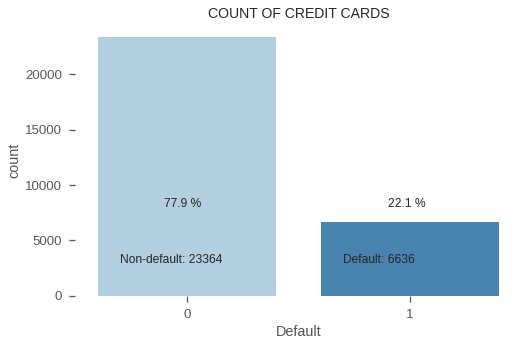

In [7]:
# The frequency of defaults
default = df.Default.sum()
non_default = len(df)-default

# Percentage
default_percentage = round(default/len(df)*100, 1)
non_default_percentage = round(non_default/len(df)*100, 1)

# ploting 
plt.figure(figsize=(8,5))
sns.set_context('notebook', font_scale=1.2)
sns.countplot('Default',data=df, palette="Blues")
plt.annotate('Non-default: {}'.format(non_default), xy=(-0.3, 15000), xytext=(-0.3, 3000), size=12)
plt.annotate('Default: {}'.format(default), xy=(0.7, 15000), xytext=(0.7, 3000), size=12)
plt.annotate(str(non_default_percentage)+" %", xy=(-0.3, 15000), xytext=(-0.1, 8000), size=12)
plt.annotate(str(default_percentage)+" %", xy=(0.7, 15000), xytext=(0.9, 8000), size=12)
plt.title('COUNT OF CREDIT CARDS', size=14)
#Removing the frame
plt.box(False);

* There are 30,000 credit card clients. 

* The average value for the amount of credit card limit is 167,484 NT dollars. The standard deviation is 129,747 NT dollars, ranging from 10,000 to 1M NT dollars.

* Education level is mostly graduate school (1) and university (2). 

* Most of the clients are either marrined or single (less frequent the other status). 

* Average age is 35.5 years, with a standard deviation of 9.2 years.

* As the value 0 for default payment means 'not default' and value 1 means 'default', the mean of 0.221 means that there are 22.1% of credit card contracts that will default next month.

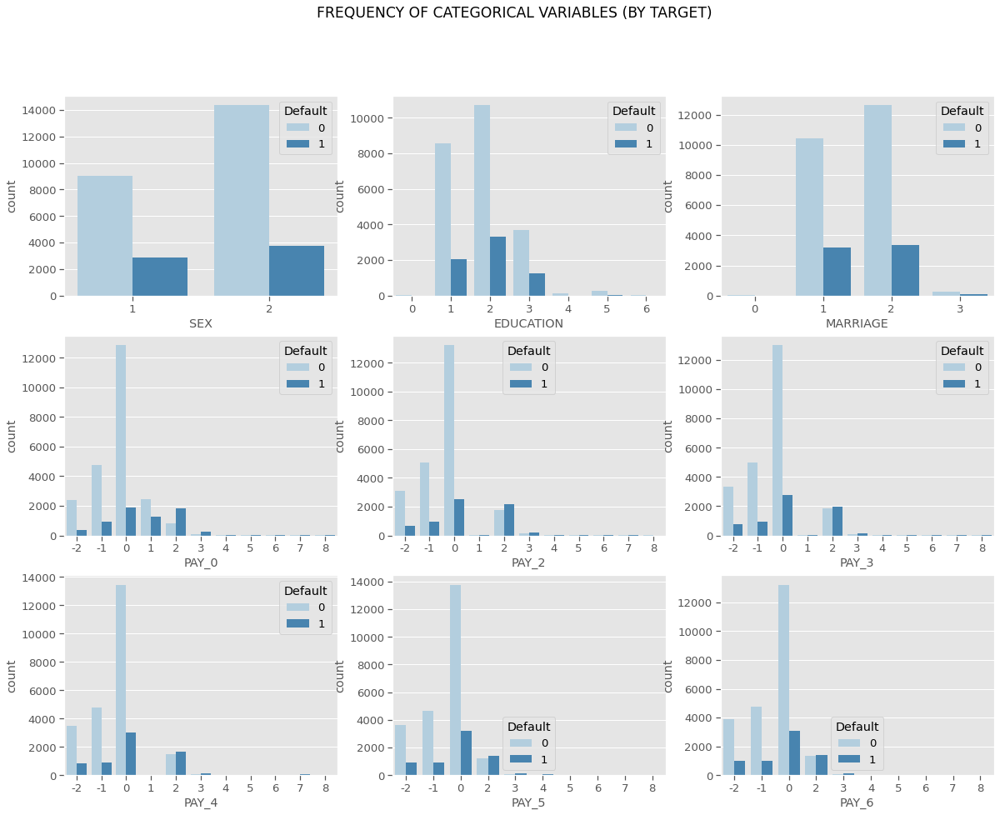

In [17]:
# Creating a new dataframe with categorical variables
subset = df[
    [
        "SEX",
        "EDUCATION",
        "MARRIAGE",
        "PAY_0",
        "PAY_2",
        "PAY_3",
        "PAY_4",
        "PAY_5",
        "PAY_6",
        "Default",
    ]
]

f, axes = plt.subplots(3, 3, figsize=(20, 15), facecolor="white")
f.suptitle("FREQUENCY OF CATEGORICAL VARIABLES (BY TARGET)")

ax1 = sns.countplot(x="SEX", hue="Default", data=subset, palette="Blues", ax=axes[0, 0])
ax2 = sns.countplot(
    x="EDUCATION", hue="Default", data=subset, palette="Blues", ax=axes[0, 1]
)
ax3 = sns.countplot(
    x="MARRIAGE", hue="Default", data=subset, palette="Blues", ax=axes[0, 2]
)
ax4 = sns.countplot(
    x="PAY_0", hue="Default", data=subset, palette="Blues", ax=axes[1, 0]
)
ax5 = sns.countplot(
    x="PAY_2", hue="Default", data=subset, palette="Blues", ax=axes[1, 1]
)
ax6 = sns.countplot(
    x="PAY_3", hue="Default", data=subset, palette="Blues", ax=axes[1, 2]
)
ax7 = sns.countplot(
    x="PAY_4", hue="Default", data=subset, palette="Blues", ax=axes[2, 0]
)
ax8 = sns.countplot(
    x="PAY_5", hue="Default", data=subset, palette="Blues", ax=axes[2, 1]
)
ax9 = sns.countplot(
    x="PAY_6", hue="Default", data=subset, palette="Blues", ax=axes[2, 2]
)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


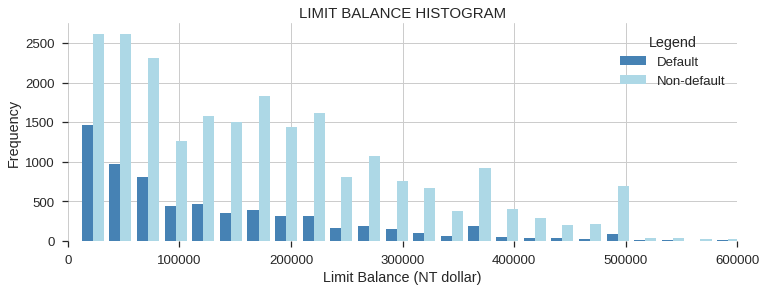

In [400]:
# Limit balance of clients
default = list(df[df["Default"] == 1]["LIMIT_BAL"])
non_default = list(df[df["Default"] == 0]["LIMIT_BAL"])

plt.figure(figsize=(12, 4))
sns.set_context("notebook", font_scale=1.2)
plt.hist([default, non_default], bins=40, color=["steelblue", "lightblue"])
plt.xlim([0, 600000])
plt.legend(
    ["Default", "Non-default"], title="Legend", loc="upper right", facecolor="white"
)
plt.xlabel("Limit Balance (NT dollar)")
plt.ylabel("Frequency")
plt.title("LIMIT BALANCE HISTOGRAM", SIZE=15)
plt.box(False)

It seems that PAY_0 (Repayment status in September) and PAY_2 (Repayment status in August) have more discriminatory power the repayment status in other months.

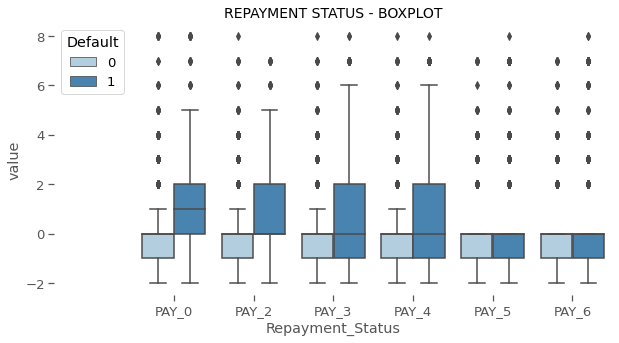

In [19]:
Repayment = df[["PAY_0", "PAY_2", "PAY_3", "PAY_4", "PAY_5", "PAY_6"]]

Repayment = pd.concat([df.Default, Repayment], axis=1)
Repayment = pd.melt(
    Repayment, id_vars="Default", var_name="Repayment_Status", value_name="value"
)

plt.figure(figsize=(10, 5))
sns.set_context("notebook", font_scale=1.2)
sns.boxplot(
    y="value", x="Repayment_Status", hue="Default", data=Repayment, palette="Blues"
)
plt.legend(loc="best", title="Default", facecolor="white")
plt.xlim([-1.5, 5.5])
plt.title("REPAYMENT STATUS - BOXPLOT", size=14)
plt.box(False)

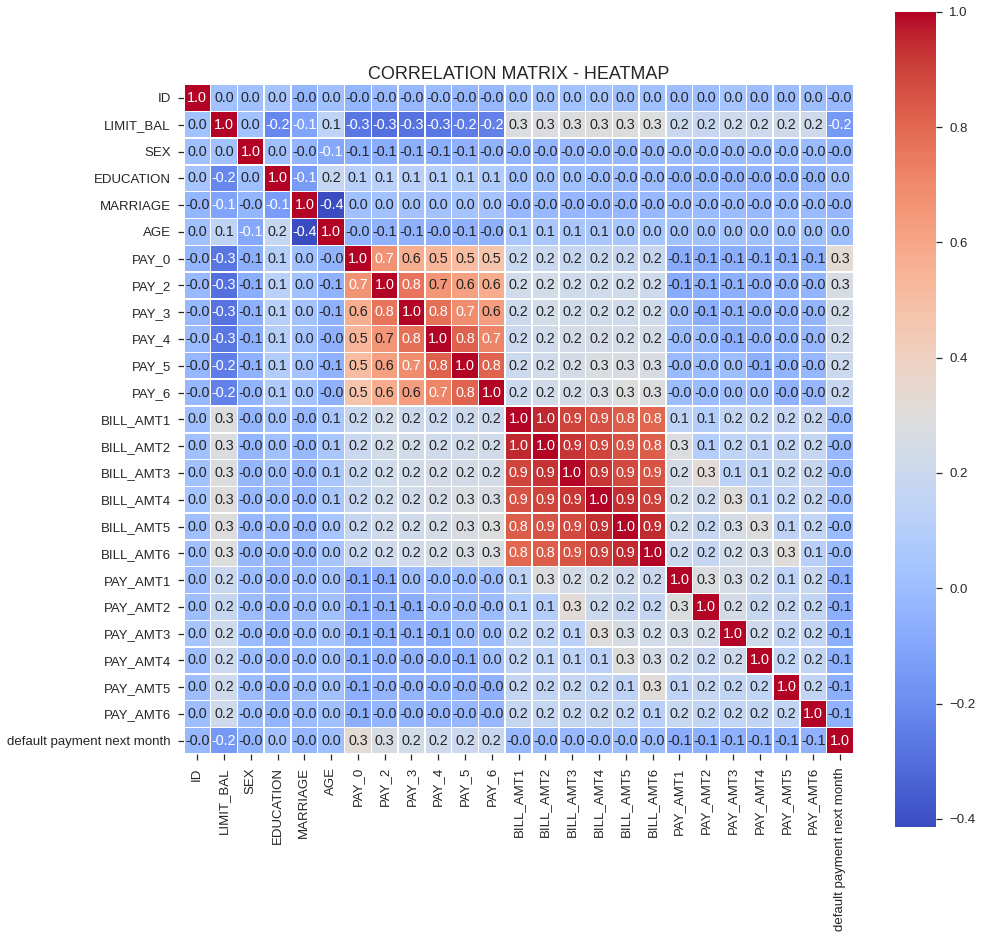

In [403]:
#  looking at correlations matrix, defined via Pearson function
corr = df.corr()  # .corr is used to find corelation
f, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(
    corr,
    cbar=True,
    square=True,
    annot=True,
    fmt=".1f",
    xticklabels=True,
    yticklabels=True,
    cmap="coolwarm",
    linewidths=0.5,
    ax=ax,
)
plt.title("CORRELATION MATRIX - HEATMAP", size=18)

The heatmat shows that features are correlated with each other (collinearity), such us like PAY_0,2,3,4,5,6 and BILL_AMT1,2,3,4,5,6. In those cases, the correlation is positive.

Uncorrelated data are poentially more useful: discriminatory!



# Automated Machine Learning

Before jumping on manual preprocessing and exploring the models, I want to explore quickly the performance of different ML models using automated ML algorithms to see what is an end product will look like. 

# Binary Classification

Binary classification is a supervised machine learning technique where the goal is to predict categorical class labels which are discrete and unoredered such as Pass/Fail, Positive/Negative, Default/Not-Default etc. A few real world use cases for classification are listed below:

Supervised machine learning algorithms which are used for classifying the elements into a binary group based on various techniques and algorithms. In this case problems is predicting customer default (yes or no),

## Setting Up the Data

In order to demonstrate the predict_model() function on unseen data, a sample of 1500 (%5) records has been withheld from the original dataset to be used for predictions. This should not be confused with a train/test split as this particular split is performed to simulate a real life scenario. Another way to think about this is that these 1500 records are not available at the time when the machine learning experiment was performed.
All sets are stratified to balance the ratio of default in each set.

But before, the ID column is deleted since it is not necessary

In [8]:
df.drop(['ID'], axis = 1, inplace = True)

In [9]:
def split_stratified_into_train_val_test(
    df_input,
    stratify_colname="y",
    frac_train=0.6,
    frac_val=0.15,
    frac_test=0.25,
    random_state=None,
):
    """
    Splits a Pandas dataframe into three subsets (train, val, and test)
    following fractional ratios provided by the user, where each subset is
    stratified by the values in a specific column (that is, each subset has
    the same relative frequency of the values in the column). It performs this
    splitting by running train_test_split() twice.

    Parameters
    ----------
    df_input : Pandas dataframe
        Input dataframe to be split.
    stratify_colname : str
        The name of the column that will be used for stratification. Usually
        this column would be for the label.
    frac_train : float
    frac_val   : float
    frac_test  : float
        The ratios with which the dataframe will be split into train, val, and
        test data. The values should be expressed as float fractions and should
        sum to 1.0.
    random_state : int, None, or RandomStateInstance
        Value to be passed to train_test_split().

    Returns
    -------
    df_train, df_val, df_test :
        Dataframes containing the three splits.
    """

    if frac_train + frac_val + frac_test != 1.0:
        raise ValueError(
            "fractions %f, %f, %f do not add up to 1.0"
            % (frac_train, frac_val, frac_test)
        )

    if stratify_colname not in df_input.columns:
        raise ValueError("%s is not a column in the dataframe" % (stratify_colname))

    X = df_input  # Contains all columns.
    y = df_input[
        [stratify_colname]
    ]  # Dataframe of just the column on which to stratify.

    # Split original dataframe into train and temp dataframes.
    df_train, df_temp, y_train, y_temp = train_test_split(
        X, y, stratify=y, test_size=(1.0 - frac_train), random_state=random_state
    )

    # Split the temp dataframe into val and test dataframes.
    relative_frac_test = frac_test / (frac_val + frac_test)
    df_val, df_test, y_val, y_test = train_test_split(
        df_temp,
        y_temp,
        stratify=y_temp,
        test_size=relative_frac_test,
        random_state=random_state,
    )

    assert len(df_input) == len(df_train) + len(df_val) + len(df_test)

    return (
        df_train.reset_index(drop=True),
        df_val.reset_index(drop=True),
        df_test.reset_index(drop=True),
    )


In [10]:
df_train, df_val, df_test = split_stratified_into_train_val_test(
    df, stratify_colname="Default", frac_train=0.70, frac_val=0.25, frac_test=0.05
)

* size of data frames

In [11]:
df_train.shape, df_val.shape, df_test.shape

((20999, 24), (7500, 24), (1501, 24))

In [12]:
df_train.Default.value_counts()

0    16354
1     4645
Name: Default, dtype: int64

In [13]:
df_val.Default.value_counts()

0    5841
1    1659
Name: Default, dtype: int64

In [14]:
df_test.Default.value_counts()

0    1169
1     332
Name: Default, dtype: int64

* The train and validation sets are again combined for automated ML process. However the separete dataframes are needed for later

In [15]:
df_train_val = pd.concat([df_train, df_val])

In [16]:
df_train_val.Default.value_counts()

0    22195
1     6304
Name: Default, dtype: int64

## Setting up Environment

Environment initialized which creates the transformation pipeline to prepare the data for modeling and deployment. It takes two mandatory parameters: a pandas dataframe and the name of the target column. All other parameters are optional and are used to customize the pre-processing pipeline 

When setup() is executed, inference algorithm will automatically infer the data types for all features based on certain properties. 



In [17]:
first_experiment = setup(data=df_train_val, target="Default", session_id=1)

,Description,Value
0,session_id,1
1,Target,Default
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(28499, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


The information grid which contains several important pieces of information. Most of the information is related to the pre-processing pipeline which is constructed when setup() is executed. The majority of these features are default in this first attempt:

Label Encoded : When the Target variable is of type string (i.e. 'Yes' or 'No') instead of 1 or 0, it automatically encodes the label into 1 and 0 and displays the mapping (0 : No, 1 : Yes) for reference. In this experiment no label encoding is required since the target variable is of type numeric.

Original Data : Displays the original shape of the dataset. In this experiment (28499, 24) means 28499 samples and 24 features including the target column.

Missing Values :  For this experiment there are no missing values in the dataset.

Numeric Features : In this dataset, 14 out of 24 features are inferred as numeric.

Categorical Features : In this dataset, 9 out of 24 features are inferred as categorical.

Transformed Train Set : Displays the shape of the transformed training set. Notice that the original shape of (28499, 24) is transformed into (19949, 88) for the transformed train set and the number of features have increased to 88 from 24 due to categorical encoding

Transformed Test Set : Displays the shape of the transformed test/hold-out set. There are 8550 samples in test/hold-out set. This split is based on the default value of 70/30.

Notice how a few tasks that are imperative to perform modeling are automatically handled such as missing value imputation (in this case there are no missing values in the training data, but we still need imputers for unseen data), categorical encoding etc. Most of the parameters in setup() are optional and used for customizing the pre-processing pipeline.

## Comparing All Models

Comparing all models to evaluate performance is the recommended starting point for modeling once the setup is completed (unless you exactly know what kind of model you need, which is often not the case). This function trains all models in the model library and scores them using stratified cross validation for metric evaluation. The output prints a score grid that shows average Accuracy, AUC, Recall, Precision, F1 and Kappa accross the folds (10 by default) of all the available models in the model library.

Since this is binary classification and I am comparing the models, I sorted them according to AUC score to see which models performs better with default settings.

In [18]:
compare_models(sort = 'AUC')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
gbc,Gradient Boosting Classifier,0.82,0.78,0.35,0.68,0.46,3.68e-01,3.96e-01,6.08
lightgbm,Light Gradient Boosting Machine,0.82,0.78,0.36,0.67,0.47,3.72e-01,3.97e-01,0.39
ada,Ada Boost Classifier,0.81,0.77,0.33,0.66,0.44,3.43e-01,3.74e-01,1.40
lda,Linear Discriminant Analysis,0.82,0.76,0.37,0.67,0.47,3.76e-01,4.00e-01,0.32
rf,Random Forest Classifier,0.81,0.76,0.36,0.65,0.46,3.58e-01,3.82e-01,3.06
et,Extra Trees Classifier,0.80,0.74,0.36,0.60,0.45,3.40e-01,3.56e-01,2.29
lr,Logistic Regression,0.78,0.65,0.00,0.00,0.00,-3.00e-04,-3.60e-03,0.78
nb,Naive Bayes,0.37,0.64,0.89,0.24,0.38,5.63e-02,1.14e-01,0.05
dt,Decision Tree Classifier,0.72,0.61,0.40,0.38,0.39,2.13e-01,2.13e-01,0.37
knn,K Neighbors Classifier,0.75,0.60,0.18,0.37,0.24,1.13e-01,1.23e-01,0.95


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=1, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

* It seems Gradient Boosting Classifier and Light Gradient Boosting Machine are giving the best AUC values.
* It is interesting that a more simple model Linear Discriminant Analysis also as powerful as the advanced models.
* Naive Bayes model gives 93% recall. This is interesting. 

### Gradient Boosting Classifier

* Result from 10 k-fold validation

In [32]:
gbc = create_model('gbc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,8.15e-01,0.77,0.33,0.67,0.45,0.35,0.38
1,8.18e-01,0.79,0.42,0.64,0.50,0.40,0.41
2,8.20e-01,0.78,0.36,0.69,0.47,0.37,0.40
3,8.31e-01,0.80,0.42,0.70,0.52,0.43,0.45
4,8.24e-01,0.81,0.37,0.70,0.48,0.39,0.42
5,8.18e-01,0.79,0.36,0.67,0.47,0.37,0.40
6,8.22e-01,0.78,0.33,0.72,0.46,0.37,0.41
7,8.16e-01,0.78,0.36,0.66,0.47,0.37,0.39
8,8.08e-01,0.76,0.34,0.63,0.44,0.34,0.36
9,8.20e-01,0.77,0.38,0.67,0.48,0.39,0.41


* Default parameters of GBC

In [33]:
print(gbc)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=1, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)


#### Tuning GBC

Here a random grid search of hyperparameters over a pre-defined search space is investigated. It is set to optimize AUC but this can be changed using optimize parameter (Optimization to Recall may be another option for the business).  The dataset is imbalanced (such as the credit dataset we are working with) accuracy is not a good metric for consideration.

In [34]:
tuned_gbc = tune_model(gbc, optimize = 'AUC')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,8.17e-01,0.77,0.34,0.67,0.46,0.36,0.39
1,8.20e-01,0.80,0.42,0.65,0.51,0.41,0.42
2,8.22e-01,0.78,0.38,0.68,0.48,0.39,0.41
3,8.33e-01,0.80,0.42,0.71,0.53,0.43,0.46
4,8.22e-01,0.81,0.37,0.69,0.48,0.39,0.41
5,8.20e-01,0.80,0.37,0.68,0.48,0.38,0.40
6,8.19e-01,0.77,0.33,0.70,0.45,0.36,0.39
7,8.16e-01,0.79,0.37,0.66,0.47,0.37,0.39
8,8.14e-01,0.77,0.36,0.65,0.46,0.36,0.39
9,8.19e-01,0.77,0.38,0.66,0.48,0.38,0.40


#### AUC Plot

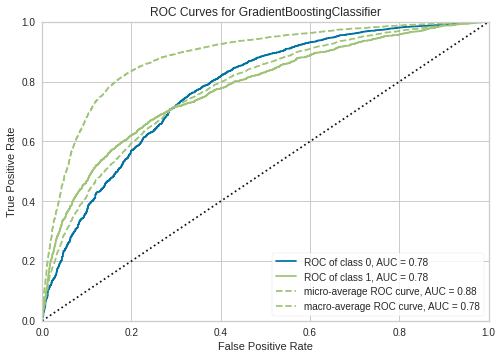

In [35]:
plot_model(tuned_gbc, plot = 'auc')

#### Threshold plot

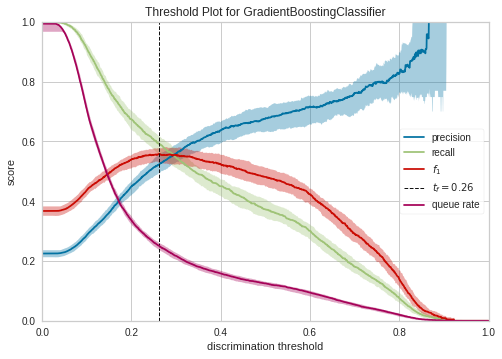

In [36]:
plot_model(tuned_gbc, plot = 'threshold')

#### Precision-Recall Curve

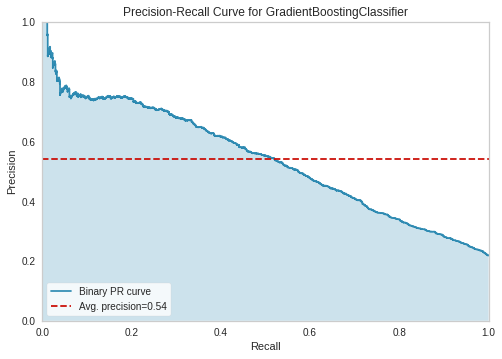

In [37]:
plot_model(tuned_gbc, plot = 'pr')

#### Confusion Matrix

* False negatives are not good, but this is a initial attempt and models is not optimized for recall 

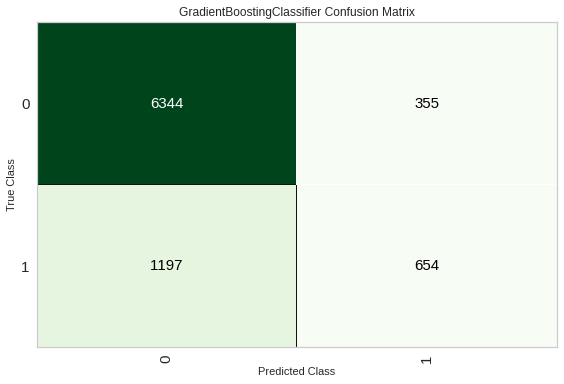

In [38]:
plot_model(tuned_gbc, plot = 'confusion_matrix')

* Here I just wanted to check what is the Naive Beyes models confusion matrix which shown in below. It seems that Recall is really high but total number false negative slighly come down.

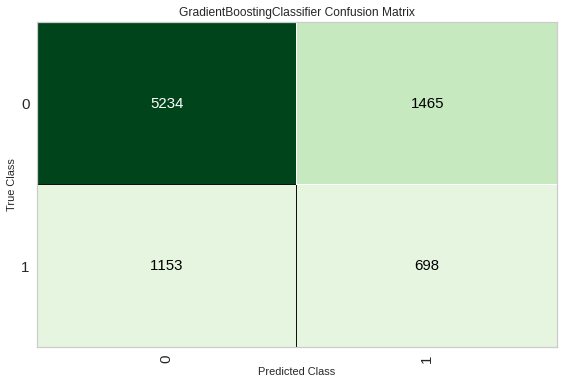

In [39]:
nb = create_model('nb')
tuned_nb = tune_model(gbc, optimize = 'Recall')
plot_model(tuned_nb, plot = 'confusion_matrix')

#### Class Report

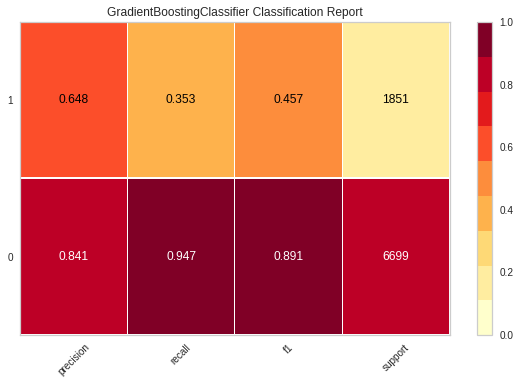

In [40]:
plot_model(tuned_gbc, plot = 'class_report')

#### Learning Curve

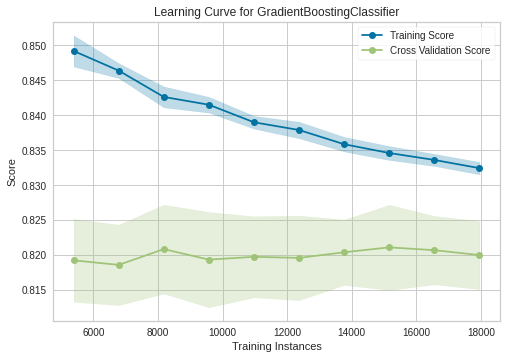

In [41]:
plot_model(tuned_gbc, plot = 'learning')

#### Feature Importance

PAY_0_2 and PAY_2_2 are top two important features.

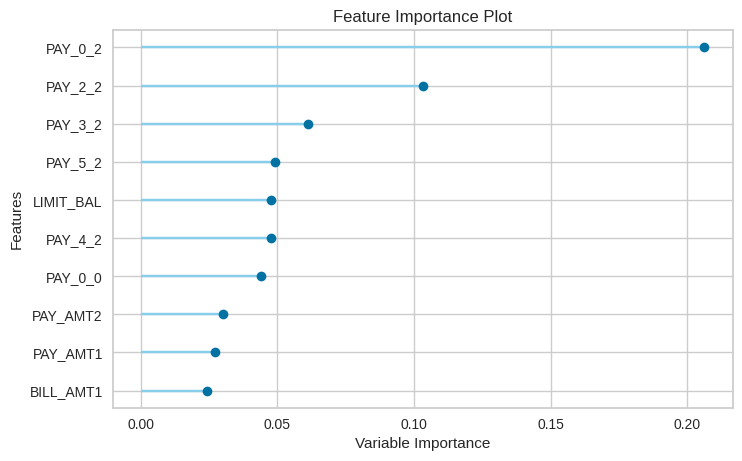

In [42]:
plot_model(tuned_gbc, plot = 'feature')

Models default parameters.

In [43]:
plot_model(tuned_gbc, plot = 'parameter')

,Parameters
ccp_alpha,0.0
criterion,friedman_mse
init,None
learning_rate,0.05
loss,deviance
max_depth,4
max_features,sqrt
max_leaf_nodes,None
min_impurity_decrease,0.05
min_impurity_split,None


In [44]:
evaluate_model(tuned_gbc)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

## Predict on test / hold-out Sample

Here, I checked by predicting the test/hold-out set and reviewing the evaluation metrics. 30% of the data has been separated out as test/hold-out as sample. All of the evaluation metrics we have seen above are cross validated results based on the training set (70%) only. Now, using our final trained model stored in the gbc variable we will predict against the hold-out sample and evaluate the metrics to see if they are materially different than the CV results. And it seems that the result almost similar.

In [45]:
predict_model(tuned_gbc);

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Gradient Boosting Classifier,0.82,0.78,0.35,0.65,0.46,0.36,0.38


The AUC on test/hold-out set is similar (0.78) compared  tuned_gbc CV results. This is no a significant difference. If there is a large variation between the test/hold-out and CV results, then this would normally indicate over-fitting but could also be due to several other factors and would require further investigation. 

## Advanced Models - 1

Above results are promissing but I have not applied and transformation on dataset. Before creating handling unbalanced data, here I am going to apply below step in the pipeline to see how transformation change the results

* Normalization: normalize and scale the dataset

Normalization / Scaling (often used interchangeably with standardization) is used to transform the actual values of numeric variables in a way that provides helpful properties for machine learning. Many algorithms such as Logistic Regression, Support Vector Machine, K Nearest Neighbors and Naive Bayes assume that all features are centered around zero and have variances that are at at the same level of order. If a particular feature in a dataset has a variance that is larger in order of magnitude than other features, the model may not understand all features correctly and could perform poorly. For instance, in the dataset we are using for this example the AGE feature ranges between 21 to 79 while other numeric features range from 10,000 to 1,000,000

Notice how the scale / range of numeric features are different. For example the AGE feature ranges from between 21 to 79 and BILL_AMT1 ranges from -165,580 to 964,511. This may cause problems for algorithms that assume all features have variance within the same order. In this case, the order of magnitude for BILL_AMT1 is widely different than AGE. We will deal with this problem by using the normalize parameter in setup

* Transformation: apply transformations that make the data linear and approximately normal

While normalization transforms the range of data to remove the impact of magnitude in variance, transformation is a more radical technique as it changes the shape of the distribution so that transformed data can be represented by a normal or approximate normal distirbution. In general, the data should be transformed if using algorithms that assume normality or a gaussian distribution. Examples of such models are Logistic Regression, Linear Discriminant Analysis (LDA) and Gaussian Naive Bayes.


* Ignore Low Variance:  remove features with statistically insignificant variances to make the experiment more efficient

Ignore Low Variance: Datasets contain categorical features that have a single unique or small number of values across samples. This kind of features are not only non-informative and add no value but are also sometimes harmful for few algorithms. Imagine a feature with only one unique value or few dominant unique values accross samples, they can be removed from the dataset by using the ignoring low variance.

* Remove Multi-collinearity: remove multi-collinearity from the dataset to boost performance of Linear algorithms

Multi-collinearity is a state of very high intercorrelations or inter-associations among the independent features in the dataset. It is a type of disturbance in the data that is not handled well by machine learning models (mostly linear algorithms). Multi-collinearity may reduce overall coefficient of the model and cause unpredictable variance. This will lead to overfitting where the model may do great on a known training set but will fail with an unknown testing set.

Numeric features are not normally distributed. Look at the distributions of LIMIT_BAL, BILL_AMT1 and PAY_AMT1 ... PAY_AMT6. A few features are also highly skewed such as PAY_AMT1. This may cause problems for algorithms that assume normal or approximate normal distributions of the data.

* Group Featuresextract statistical information from related features in the dataset

Sometimes datasets may contain features that are related at a sample level. For example in the credit dataset there are features called BILL_AMT1 .. BILL_AMT6 which are related in such a way that BILL_AMT1 is the amount of the bill 1 month ago and BILL_AMT6 is the amount of the bill 6 months ago. Such features can be used to extract additional features based on the statistical properties of the distribution such as mean, median, variance, standard deviation etc.

* Bin Numeric Variables: to bin numeric variables and transform numeric features into categorical ones using 'sturges' rule

Binning or discretization is the process of transforming numerical variables into categorical features. The Age variable which is a continious distribution of numeric values that can be discretized into intervals (10-20 years, 21-30 etc.). Binning may improve the accuracy of a predictive model by reducing the noise or non-linearity in the data. 

* Model Ensembling and Stacking: to boost model performance using several ensembling techniques such as Bagging, Boosting, Soft/hard Voting and Generalized Stacking

Ensemble modeling is a process where multiple diverse models are created to predict an outcome. This is achieved either by using many different modeling algorithms or using different samples of training data sets. The ensemble model then aggregates the predictions of each base model resulting in one final prediction for the unseen data. The motivation for using ensemble models is to reduce the generalization error of the prediction. As long as the base models are diverse and independent, the prediction error of the model decreases when the ensemble approach is used. The two most common methods in ensemble learning are Bagging and Boosting. Stacking is also a type of ensemble learning where predictions from multiple models are used as input features for a meta model that predicts the final outcome.

* Model Calibration: to calibrate probabilities of a classification model

In [46]:
second = setup(
    data=df_train_val,
    target="Default",
    session_id=2,
    normalize=True,
    transformation=True,
    ignore_low_variance=True,
    remove_multicollinearity=True,
    multicollinearity_threshold=0.95,
    bin_numeric_features=["LIMIT_BAL", "AGE"],
    group_features=[
        ["BILL_AMT1", "BILL_AMT2", "BILL_AMT3", "BILL_AMT4", "BILL_AMT5", "BILL_AMT6"],
        ["PAY_AMT1", "PAY_AMT2", "PAY_AMT3", "PAY_AMT4", "PAY_AMT5", "PAY_AMT6"],
    ],
    log_experiment=True,
    experiment_name="credit1",
)

,Description,Value
0,session_id,2
1,Target,Default
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(28499, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


* It seems that above transformation have not improved the result that much.
* Linear Discriminant Analysis and Logistic regression performances improved because normalization and transfrormation. 

In [47]:
compare_models(sort = 'AUC') 

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
gbc,Gradient Boosting Classifier,0.82,0.78,0.36,0.68,0.47,0.37,0.40,10.88
lightgbm,Light Gradient Boosting Machine,0.82,0.78,0.37,0.66,0.48,0.38,0.40,0.60
lda,Linear Discriminant Analysis,0.82,0.78,0.38,0.67,0.49,0.39,0.41,0.51
ada,Ada Boost Classifier,0.82,0.78,0.33,0.68,0.45,0.35,0.38,2.48
rf,Random Forest Classifier,0.81,0.76,0.37,0.65,0.47,0.37,0.39,4.50
et,Extra Trees Classifier,0.81,0.75,0.37,0.63,0.47,0.36,0.38,2.89
lr,Logistic Regression,0.78,0.70,0.09,0.57,0.15,0.10,0.16,0.87
nb,Naive Bayes,0.41,0.67,0.87,0.26,0.40,0.08,0.14,0.07
knn,K Neighbors Classifier,0.76,0.62,0.22,0.41,0.28,0.15,0.16,0.72
dt,Decision Tree Classifier,0.72,0.61,0.41,0.38,0.39,0.21,0.21,0.74


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=2, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

* I wanted to try how this transformations helped to improve modes by looking confussion matrix. This result better than previous training. 

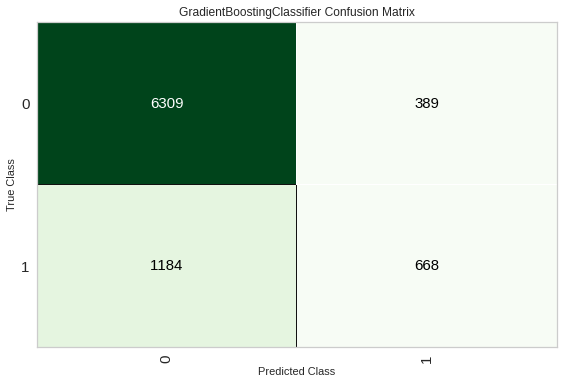

In [48]:
gbc = create_model("gbc")
tuned_gbc = tune_model(gbc, optimize="Recall")
plot_model(tuned_gbc, plot="confusion_matrix")

## Handling Unbalanced Data

* I used a SMOTE algorithm to balance dataset. 

In [51]:
third = setup(
    data=df_train_val,
    target="Default",
    session_id=3,
    normalize=True,
    transformation=True,
    ignore_low_variance=True,
    remove_multicollinearity=True,
    multicollinearity_threshold=0.95,
    bin_numeric_features=["LIMIT_BAL", "AGE"],
    group_features=[
        ["BILL_AMT1", "BILL_AMT2", "BILL_AMT3", "BILL_AMT4", "BILL_AMT5", "BILL_AMT6"],
        ["PAY_AMT1", "PAY_AMT2", "PAY_AMT3", "PAY_AMT4", "PAY_AMT5", "PAY_AMT6"],
    ],
    log_experiment=True,
    experiment_name="credit1",
    fix_imbalance=True,
    fix_imbalance_method=imblearn.over_sampling.SMOTE(),
    data_split_stratify=True,
)

,Description,Value
0,session_id,3
1,Target,Default
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(28499, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


In [52]:
compare_models(sort="AUC")

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
gbc,Gradient Boosting Classifier,0.82,0.78,0.40,0.64,0.49,0.39,0.40,21.57
lightgbm,Light Gradient Boosting Machine,0.82,0.78,0.39,0.64,0.49,0.38,0.40,1.72
lda,Linear Discriminant Analysis,0.77,0.77,0.59,0.48,0.53,0.38,0.38,1.12
ada,Ada Boost Classifier,0.81,0.76,0.42,0.61,0.50,0.39,0.40,4.97
rf,Random Forest Classifier,0.81,0.76,0.40,0.63,0.49,0.38,0.40,6.76
et,Extra Trees Classifier,0.81,0.75,0.40,0.61,0.48,0.37,0.39,4.94
qda,Quadratic Discriminant Analysis,0.79,0.72,0.09,0.66,0.16,0.11,0.19,0.80
lr,Logistic Regression,0.73,0.70,0.49,0.41,0.45,0.27,0.27,0.82
nb,Naive Bayes,0.37,0.67,0.90,0.25,0.39,0.07,0.13,0.42
dt,Decision Tree Classifier,0.73,0.62,0.42,0.40,0.41,0.24,0.24,1.23


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=3, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

* It seems that oversampling have not improved the overall results significantly. 
* Although Gradient Boosting Classifier gave the best AUC score, it took much more compared to other methods.
* Linear Discriminant Analysis outperformed in recall with having almost the same AUC score. LDA also gave the best F1 score.
* LDA seems gives the better result. However, LDA is improved due to many transformation. LDA may assume expected distribution on the input data. 

In [53]:
lda = create_model("lda")
tuned_lda = tune_model(lda, optimize="Recall")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,4.57e-01,0.63,0.81,2.62e-01,3.96e-01,9.35e-02,0.14
1,4.56e-01,0.66,0.83,2.65e-01,4.02e-01,1.01e-01,0.16
2,4.76e-01,0.66,0.81,2.72e-01,4.07e-01,1.13e-01,0.17
3,4.73e-01,0.65,0.83,2.72e-01,4.09e-01,1.15e-01,0.18
4,4.78e-01,0.65,0.83,2.75e-01,4.14e-01,1.22e-01,0.19
5,4.68e-01,0.64,0.81,2.68e-01,4.03e-01,1.06e-01,0.16
6,4.71e-01,0.63,0.80,2.68e-01,4.01e-01,1.04e-01,0.16
7,4.67e-01,0.64,0.81,2.68e-01,4.03e-01,1.05e-01,0.16
8,4.64e-01,0.65,0.81,2.67e-01,4.02e-01,1.03e-01,0.16
9,4.60e-01,0.63,0.80,2.63e-01,3.96e-01,9.45e-02,0.14


In [54]:
evaluate_model(tuned_lda) #, use_train_data=True

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [55]:
evaluate_model(tuned_lda, use_train_data=True)  # , use_train_data=True

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

* This results are better than the previous results. 
* Although the number False Positives increased, there are less False Negatives. 

* My take away from initial models is that I can improve results if I make preprocess the data and maybe with some feature engineering.
* I also do not want to depend on automatic ML algorithms so I will develop the Light Gradient Boosting Machine algorithm from scratch.
* There is couple reason for this:
1. LGBM is very fast. During training and hyperparameter, LGBM outperforms.
2. LGBM is a tree-based algorithm so it does not require data normalization, transformation, etc. So it is much easier to handle it.
 

# Preprocessing


In [ ]:
# below code is put in here incase we need to restart the dataset again
"""df = pd.read_excel("default of credit card clients.xls", header=1)
df.rename(columns={"default payment next month": "Default","PAY_0": "PAY_1"}, inplace=True)
df.drop(['ID'], axis = 1, inplace = True)"""

## Discrepancies in data

* First of all the distribution of age in all columns has some strange distribution
* After ID > 15000, a different timepoint data might be used.

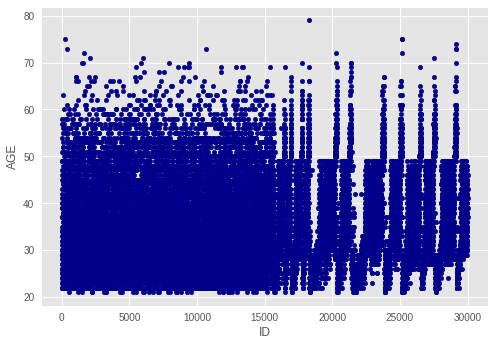

In [58]:
df.plot.scatter(x="ID", y="AGE", c="DarkBlue")

In [59]:
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,Default
0,1,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0


* There are two client with negative bill amounts.

 

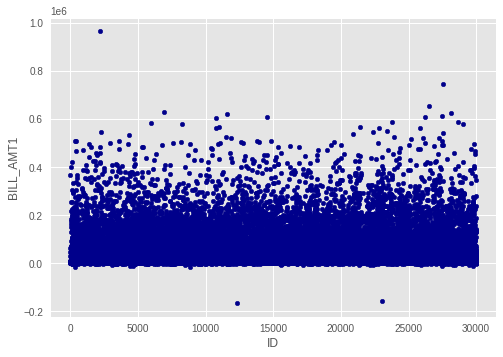

In [60]:
df.plot.scatter(x="ID", y="BILL_AMT1", c="DarkBlue")

* There are couple of client with really large pay amounts. These clienst are worth to explore.
* There similar extreme values exist in the dataset for other pay amount.


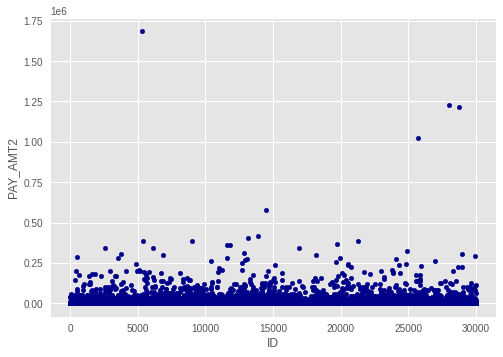

In [61]:
ddf.plot.scatter(x="ID", y="PAY_AMT2", c="DarkBlue")

* There are multiple IDs with PAY_0…6 all = -2 and BILL_AMT_1…6 all = 0, yet default = 1. How is that possible? A customer did not use credit for the last 6 months and no bills issued for the last 6 months, but still default. See ID46 as an example of this.

In [62]:
df.loc[df["ID"] == 46]


,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,Default
45,46,210000,1,1,2,29,-2,-2,-2,-2,-2,-2,0,0,0,0,0,0,0,0,0,0,0,0,1


We do not need ID in the dataset, it is deleted.

In [ ]:
#df.drop(["ID"], axis=1, inplace=True)

## Education

* The distribution of Education information.
* EDUCATION (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)

In [20]:
def correlation_percentages(df, Col1, Col2):

    """
    This function works as crosstab function in pandas.
    But gives the percentages.
    inputs : dataframe and column names to look at
    output : dataframe
    """
    # group two column
    result = df.groupby([Col1, Col2]).size().unstack()

    # add percentages
    result["perc"] = result[result.columns[1]] / (
        result[result.columns[0]] + result[result.columns[1]]
    )

    return result

In [5]:
correlation_percentages(df, "EDUCATION", "Default")

Default,0,1,perc
EDUCATION,,,
0,14.0,NaN,NaN
1,8549.0,2036.0,0.19
2,10700.0,3330.0,0.24
3,3680.0,1237.0,0.25
4,116.0,7.0,0.06
5,262.0,18.0,0.06
6,43.0,8.0,0.16


### Pre-process for Education
 
* There is 0 class but it is not defined and all values are non-default. They are deleted.
* Categories of 5 and 6 also combined since they might mean the same thing.


In [21]:
def preprocess_education(df):

    """
    This function corrects the information on Education.
    """

    # delete the education where 0 is not known. All the defaults are zero
    df.drop(df[df["EDUCATION"] == 0].index, inplace=True)

    # convert education 5, 6 information to 4 so that all unknows
    df.loc[df.EDUCATION == 6, "EDUCATION"] = 5

    return df

In [22]:
df = preprocess_education(df)

In [68]:
correlation_percentages(df, "EDUCATION", "Default")

Default,0,1,perc
EDUCATION,,,
1,8549,2036,0.19
2,10700,3330,0.24
3,3680,1237,0.25
4,116,7,0.06
5,305,26,0.08


## Marital Status

There is a 0 class that is not defined.
Marital status (1 = married; 2 = single; 3 = others).
I am assuming unknown can be considered as others.

In [69]:
correlation_percentages(df, "MARRIAGE", "Default")

Default,0,1,perc
MARRIAGE,,,
0,49,5,0.09
1,10449,3206,0.23
2,12613,3341,0.21
3,239,84,0.26


In [23]:
def preprocess_marital_status(df):

    """
    This function converts 0 marital status to 3 (others).
    """

    # convert education 5, 6 information to 4 so that all unknows
    df.loc[df.MARRIAGE == 0, "MARRIAGE"] = 3

    return df

In [24]:
df = preprocess_marital_status(df)

In [72]:
correlation_percentages(df, "MARRIAGE", "Default")

Default,0,1,perc
MARRIAGE,,,
1,10449,3206,0.23
2,12613,3341,0.21
3,288,89,0.24


### Gender

I do not see any undefined category in gender.

In [73]:
correlation_percentages(df, "SEX", "Default")

Default,0,1,perc
SEX,,,
1,9007,2873,0.24
2,14343,3763,0.21


In [25]:
def onehot_encode(df_input, column_dict):

    """
    Splits a Pandas dataframe into onehot coding.

    Parameters
    ----------
    df_input : Pandas dataframe
        Input dataframe to be split.
    stratify_colname : str
        Dictionary for each column

    Returns
    -------
    df_output : Pandas dataframe
    """

    df_input = df_input.copy()
    for column, prefix in column_dict.items():

        # for each column return the dummies by predefined prefix
        dummies = pd.get_dummies(df_input[column], prefix=prefix)

        # combine the dataframes
        df_input = pd.concat([df_input, dummies], axis=1)

        # drop the columns
        df_output = df_input.drop(column, axis=1)

    return df_output

# Feature Engineering

#### Gender and Marital Status

I saw that men are most likely to default and also that married people are most likely to default. Thus combining them in a single variable given by the product of the two. I chose these two first because they are both labeled 1,2 and they both decrease the probability of defaulting if their value increases. According to our models, SEX and MARRIAGE are the least important variables, so it can be worth combining them.
 
This operation will create a category for a married man, which I expect to be the one with a high probability of default, a combination of married women and single man, a category (expected to be numerically less populated) of "divorced" men (in other words, the "other" in marriage times the "male" in sex), one for single women and one for "divorced" women.
 
I can see clearly that married men have a higher probability of default, single men have nothing special with respect to all populations and single women have a low probability of default. Among the divorced, men have more troubles (but these categories are not very much populated).


In [26]:
df["SE_MA"] = 0
df.loc[((df.SEX == 1) & (df.MARRIAGE == 1)), "SE_MA"] = 1  # married man
df.loc[((df.SEX == 1) & (df.MARRIAGE == 2)), "SE_MA"] = 2  # single man
df.loc[((df.SEX == 1) & (df.MARRIAGE == 3)), "SE_MA"] = 3  # divorced man
df.loc[((df.SEX == 2) & (df.MARRIAGE == 1)), "SE_MA"] = 4  # married woman
df.loc[((df.SEX == 2) & (df.MARRIAGE == 2)), "SE_MA"] = 5  # single woman
df.loc[((df.SEX == 2) & (df.MARRIAGE == 3)), "SE_MA"] = 6  # divorced woman

In [77]:
correlation_percentages(df, "SE_MA", "Default")

Default,0,1,perc
SE_MA,,,
1,3842,1346,0.26
2,5062,1485,0.23
3,103,42,0.29
4,6607,1860,0.22
5,7551,1856,0.20
6,185,47,0.20


#### Age bin

I prepared the age as a categorical value as shown below.

In [27]:
df["AgeBin"] = 0  # creates a column of 0
df.loc[((df["AGE"] > 20) & (df["AGE"] < 30)), "AgeBin"] = 1
df.loc[((df["AGE"] >= 30) & (df["AGE"] < 40)), "AgeBin"] = 2
df.loc[((df["AGE"] >= 40) & (df["AGE"] < 50)), "AgeBin"] = 3
df.loc[((df["AGE"] >= 50) & (df["AGE"] < 60)), "AgeBin"] = 4
df.loc[((df["AGE"] >= 60) & (df["AGE"] < 81)), "AgeBin"] = 5

#### Age and Gender Relationship

In [79]:
correlation_percentages(df, "AgeBin", "Default")

Default,0,1,perc
AgeBin,,,
1,7420,2197,0.23
2,8955,2276,0.20
3,4974,1485,0.23
4,1758,582,0.25
5,243,96,0.28


In [80]:
correlation_percentages(df, "AgeBin", "SEX")
# 1 -> male 2-> female

SEX,1,2,perc
AgeBin,,,
1,3280,6337,0.66
2,4561,6670,0.59
3,2768,3691,0.57
4,1092,1248,0.53
5,179,160,0.47


The default probability goes down in your 30's and then goes higher and higher. At the same time, the percentage of men is decreasing with the age category. Thus I want to combine the two.

In [28]:
df["SE_AG"] = 0
df.loc[((df.SEX == 1) & (df.AgeBin == 1)), "SE_AG"] = 1  # man in 20's
df.loc[((df.SEX == 1) & (df.AgeBin == 2)), "SE_AG"] = 2  # man in 30's
df.loc[((df.SEX == 1) & (df.AgeBin == 3)), "SE_AG"] = 3  # man in 40's
df.loc[((df.SEX == 1) & (df.AgeBin == 4)), "SE_AG"] = 4  # man in 50's
df.loc[((df.SEX == 1) & (df.AgeBin == 5)), "SE_AG"] = 5  # man in 60's and above
df.loc[((df.SEX == 2) & (df.AgeBin == 1)), "SE_AG"] = 6  # woman in 20's
df.loc[((df.SEX == 2) & (df.AgeBin == 2)), "SE_AG"] = 7  # woman in 30's
df.loc[((df.SEX == 2) & (df.AgeBin == 3)), "SE_AG"] = 8  # woman in 40's
df.loc[((df.SEX == 2) & (df.AgeBin == 4)), "SE_AG"] = 9  # woman in 50's
df.loc[((df.SEX == 2) & (df.AgeBin == 5)), "SE_AG"] = 10  # woman in 60's and above


In [14]:
correlation_percentages(df, "SE_AG", "Default")

Default,0,1,perc
SE_AG,,,
1,2491,789,0.24
2,3511,1050,0.23
3,2077,691,0.25
4,797,295,0.27
5,131,48,0.27
6,4929,1408,0.22
7,5444,1226,0.18
8,2897,794,0.22
9,961,287,0.23


#### Billing vs Limit 

It makes sense how far the bill is from the balance limit, thus I will create that variable. Since the result can vary a lot from one client to the other (the LIMIT_BAL variable has a very wide range), I will again weigh this difference on the LIMIT_BAL feature. Again, I want to keep the historical trend of the variable

In [29]:
df["Closeness_6"] = (df.LIMIT_BAL - df.BILL_AMT6) / df.LIMIT_BAL
df["Closeness_5"] = (df.LIMIT_BAL - df.BILL_AMT5) / df.LIMIT_BAL
df["Closeness_4"] = (df.LIMIT_BAL - df.BILL_AMT4) / df.LIMIT_BAL
df["Closeness_3"] = (df.LIMIT_BAL - df.BILL_AMT3) / df.LIMIT_BAL
df["Closeness_2"] = (df.LIMIT_BAL - df.BILL_AMT2) / df.LIMIT_BAL
df["Closeness_1"] = (df.LIMIT_BAL - df.BILL_AMT1) / df.LIMIT_BAL

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29986 entries, 0 to 29999
Data columns (total 34 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   ID           29986 non-null  int64  
 1   LIMIT_BAL    29986 non-null  int64  
 2   SEX          29986 non-null  int64  
 3   EDUCATION    29986 non-null  int64  
 4   MARRIAGE     29986 non-null  int64  
 5   AGE          29986 non-null  int64  
 6   PAY_1        29986 non-null  int64  
 7   PAY_2        29986 non-null  int64  
 8   PAY_3        29986 non-null  int64  
 9   PAY_4        29986 non-null  int64  
 10  PAY_5        29986 non-null  int64  
 11  PAY_6        29986 non-null  int64  
 12  BILL_AMT1    29986 non-null  int64  
 13  BILL_AMT2    29986 non-null  int64  
 14  BILL_AMT3    29986 non-null  int64  
 15  BILL_AMT4    29986 non-null  int64  
 16  BILL_AMT5    29986 non-null  int64  
 17  BILL_AMT6    29986 non-null  int64  
 18  PAY_AMT1     29986 non-null  int64  
 19  PAY_

In [32]:
column_dictionary = {
    "EDUCATION": "EDU",
    "MARRIAGE": "MAR",
    "PAY_0": "PAY_1",
    "PAY_2": "PAY_2",
    "PAY_3": "PAY_3",
    "PAY_4": "PAY_4",
    "PAY_5": "PAY_5",
    "PAY_6": "PAY_6",
    "SE_MA": "SEMA",
    "AgeBin": "AGE",
    "SE_AG": "SEAG",
    "SEX": "GENDER",
}

In [33]:
df = onehot_encode(df, column_dictionary)

In [28]:
df.head()

,ID,LIMIT_BAL,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,Default,Closeness_6,Closeness_5,Closeness_4,Closeness_3,Closeness_2,Closeness_1,EDU_1,EDU_2,EDU_3,EDU_4,EDU_5,MAR_1,MAR_2,MAR_3,PAY_1_-2,PAY_1_-1,PAY_1_0,PAY_1_1,PAY_1_2,PAY_1_3,PAY_1_4,PAY_1_5,PAY_1_6,PAY_1_7,PAY_1_8,PAY_2_-2,PAY_2_-1,PAY_2_0,PAY_2_1,PAY_2_2,PAY_2_3,PAY_2_4,PAY_2_5,PAY_2_6,PAY_2_7,PAY_2_8,PAY_3_-2,PAY_3_-1,PAY_3_0,PAY_3_1,PAY_3_2,PAY_3_3,PAY_3_4,PAY_3_5,PAY_3_6,PAY_3_7,PAY_3_8,PAY_4_-2,PAY_4_-1,PAY_4_0,PAY_4_1,PAY_4_2,PAY_4_3,PAY_4_4,PAY_4_5,PAY_4_6,PAY_4_7,PAY_4_8,PAY_5_-2,PAY_5_-1,PAY_5_0,PAY_5_2,PAY_5_3,PAY_5_4,PAY_5_5,PAY_5_6,PAY_5_7,PAY_5_8,PAY_6_-2,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8,SEMA_1,SEMA_2,SEMA_3,SEMA_4,SEMA_5,SEMA_6,AGE_1,AGE_2,AGE_3,AGE_4,AGE_5,SEAG_1,SEAG_2,SEAG_3,SEAG_4,SEAG_5,SEAG_6,SEAG_7,SEAG_8,SEAG_9,SEAG_10,GENDER_1
0,1,20000,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1,1.00,1.00,1.00,0.97,0.84,0.80,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
1,2,120000,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1,0.97,0.97,0.97,0.98,0.99,0.98,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
2,3,90000,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0,0.83,0.83,0.84,0.85,0.84,0.68,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
3,4,50000,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0,0.41,0.42,0.43,0.01,0.04,0.06,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
4,5,50000,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0,0.62,0.62,0.58,0.28,0.89,0.83,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1


* The unneccessary columns are deleted

In [35]:
drop_columns = [
    #"ID",
    "EDUCATION",
    "MARRIAGE",
    "AGE",
    "PAY_0",
    "PAY_2",
    "PAY_3",
    "PAY_4",
    "PAY_5",
    "SE_MA",
    "AgeBin",
    "GENDER_2",
]
df = df.drop(drop_columns, axis=1)

### Saving dataset

In [36]:
pickle.dump(df, open( "dataset.pickle", "wb" ) )

* This is for loading.

In [294]:
df = pickle.load(open( "dataset.pickle", "rb" ))

In [405]:
# incase needed to delete ID after installing all dataset
#df.drop(['ID'], axis=1, inplace=True)

In [39]:
df_train, df_val, df_test = split_stratified_into_train_val_test(
    df, stratify_colname="Default", frac_train=0.70, frac_val=0.25, frac_test=0.05)

In [40]:
df_train.shape

(20990, 116)

* Preparing data to train by converting input and outputs as a dataframe

In [41]:
X_train = df_train.drop(["Default"], axis=1)
y_train = df_train["Default"]

X_val = df_val.drop(["Default"], axis=1)
y_val = df_val["Default"]

X_test = df_test.drop(["Default"], axis=1)
y_test = df_test["Default"]

#  Light Gradient Boosting Machine

I will investigate:
 
1. with original sampling
2. with do upsample the minority class
3. with SMOTE
 
* The downsample can discard potentially useful information and the sample can be biased, but it helps to improve the run time


In [42]:
df_majority = df_train[df_train.Default == 0]
df_minority = df_train[df_train.Default == 1]

print(df_majority.Default.count())
print("-----------")
print(df_minority.Default.count())
print("-----------")
print(df_train.Default.value_counts())

16345
-----------
4645
-----------
0    16345
1     4645
Name: Default, dtype: int64


### 2. Upsampling Method

* The upsample has the disadvantage of increasing the likelihood of overfitting since it replicates the minority class event. It usually outperform the downsampling.



In [43]:
df_minority_upsampled = resample(
    df_minority,
    replace=True,  # sample with replacement
    n_samples=16345,  # to match majority class
    random_state=1,
)  # reproducible results
# Combine majority class with upsampled minority class
df_upsampled = pd.concat([df_majority, df_minority_upsampled])
# Display new class counts
df_upsampled.Default.value_counts()

1    16345
0    16345
Name: Default, dtype: int64

### 3. SMOTE 

In [ ]:
sm = SMOTE(random_state=1, ratio=1.0)
X_SMOTE, y_SMOTE = sm.fit_sample(X_train, y_train.ravel())
print(len(y_SMOTE))
print(y_SMOTE.sum())

Now, I have three traing set

* X_train, y_train, with their unbalance and their authenticity
* df_upsample, which is balanced but at overfitting risk
* X_SMOTE, y_SMOTE, which is syntetic 


# Creating Model 

At this point I decided not to include SMOTE techniqes to balance the dataset because auto ML showed that oversampling did not help to LGBMClassifier.

First of all, I look how lightgbm is changing with various parameters.

In [50]:
lightgbm = LGBMClassifier()
lightgbm.fit(X_train, y_train)

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

#### Effect of Three size

* Recall is increasing with three sizes.

In [262]:
def get_models_trees():

    """
    get a list of models to evaluate
    """
    models = {}
    trees = [10, 15, 23, 30, 40, 60, 100]
    for n in trees:
        models[str(n)] = LGBMClassifier(n_estimators=n)
    return models


def evaluate_model(model):

    """
    evaluate a given model using cross-validation
    """

    cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=1)
    scores = cross_val_score(
        model, X_train, y_train, scoring="recall", cv=cv, n_jobs=-1
    )
    return scores

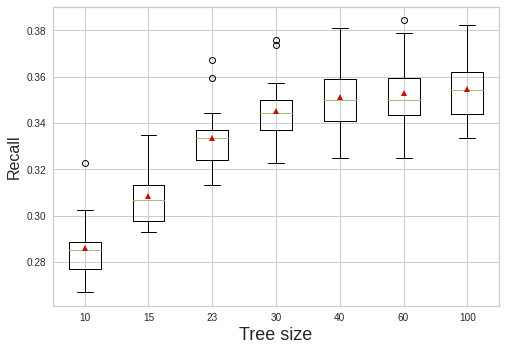

In [263]:
# get the models to evaluate later
models = get_models_trees()

results, names = [], []

for name, model in models.items():
    scores = evaluate_model(model)
    results.append(scores)
    names.append(name)

plt.boxplot(results, labels=names, showmeans=True)
plt.xlabel("Tree size", fontsize=18)
plt.ylabel("Recall", fontsize=16)
plt.show()

#### Effect of Tree Depth

* Recall increases with depth.

In [161]:
def get_models_depth():

    """
    get a list of models to evaluate
    """
    models = {}
    for i in range(1, 11):
        models[str(i)] = LGBMClassifier(max_depth=i, num_leaves=2 ** i)
    return models

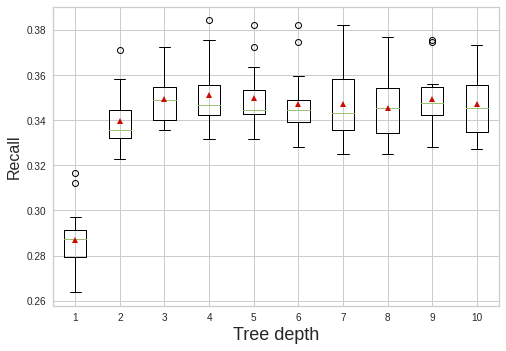

In [162]:
# get the models to evaluate later
models = get_models_depth()

results, names = [], []

for name, model in models.items():
    scores = evaluate_model(model)
    results.append(scores)
    names.append(name)

plt.boxplot(results, labels=names, showmeans=True)
plt.xlabel("Tree depth", fontsize=18)
plt.ylabel("Recall", fontsize=16)
plt.show()

#### Effect of Learning Rate

* Optimum learning rate found 1.0.

In [168]:
def get_models_learnin_rate():

    """
    get a list of models to evaluate
    """
    models = {}
    rates = [0.8, 0.9, 1.0, 1.1, 1.2]
    for rate in rates:
        key = "%.4f" % rate
        models[key] = LGBMClassifier(learning_rate=rate)
    return models

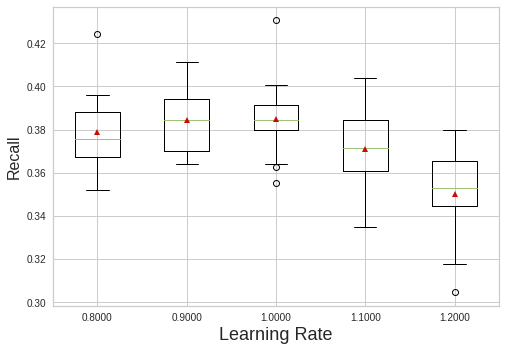

In [169]:
# get the models to evaluate later
models = get_models_learnin_rate()

results, names = [], []

for name, model in models.items():
    scores = evaluate_model(model)
    results.append(scores)
    names.append(name)

plt.boxplot(results, labels=names, showmeans=True)
plt.xlabel("Learning Rate", fontsize=18)
plt.ylabel("Recall", fontsize=16)
plt.show()

## Fine Tuning - Hyperparameter adjusting

In [51]:
lightgbm_tuned = LGBMClassifier(
    boosting_type="gbdt",
    objective="binary",
    metric=["binary_logloss"],
    max_bin=512,
    learning_rate=1,
    feature_fraction=0.9,
    bagging_fraction=0.9,
    bagging_freq=70,
    verbose=100,
    reg_alpha=50,
    reg_lambda=5,
    max_depth=4,
    num_tree=40,
)

I searched the regulirazation because it seems untuned model was overfitting the data.

In [47]:
# Create parameters to search
gridParams = {
    "reg_alpha": [1, 1.2, 2, 5, 10, 50, 100],
    "reg_lambda": [1, 1.2, 2, 5, 10, 50, 100],
}

* Grid searching method is used to find reguliraztion parameters.

In [ ]:
# View the default model params:
lightgbm_tuned.get_params().keys()
# Create the grid
grid = GridSearchCV(lightgbm_tuned, gridParams, verbose=2, cv=4, n_jobs=-1)
# Run the grid
grid.fit(X_train, y_train)

# Print the best parameters found
print(grid.best_params_)
print(grid.best_score_)

In [ ]:
lightgbm_tuned_mode = lightgbm_tuned.fit(X_train, y_train)

* Training and Validation predictions

In [53]:
y_pred_train = lightgbm_tuned_mode.predict(X_train)
y_pred_val = lightgbm_tuned_mode.predict(X_val)

* Preparing confusion matrix

In [54]:
cf_matrix_traing = confusion_matrix(y_train, y_pred_train, labels=[0, 1])
cf_matrix_val = confusion_matrix(y_val, y_pred_val, labels=[0, 1])

In [57]:
def make_confusion_matrix(
    cf,
    group_names=None,
    categories="auto",
    count=True,
    percent=True,
    cbar=True,
    xyticks=True,
    xyplotlabels=True,
    sum_stats=True,
    figsize=None,
    cmap="Blues",
    title=None,
):
    """
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html

    title:         Title for the heatmap. Default is None.
    """

    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ["" for i in range(cf.size)]

    if group_names and len(group_names) == cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = [
            "{0:.2%}".format(value) for value in cf.flatten() / np.sum(cf)
        ]
    else:
        group_percentages = blanks

    box_labels = [
        f"{v1}{v2}{v3}".strip()
        for v1, v2, v3 in zip(group_labels, group_counts, group_percentages)
    ]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0], cf.shape[1])

    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        # Accuracy is sum of diagonal divided by total observations
        accuracy = np.trace(cf) / float(np.sum(cf))

        # if it is a binary confusion matrix, show some more stats
        if len(cf) == 2:
            # Metrics for Binary Confusion Matrices
            precision = cf[1, 1] / sum(cf[:, 1])
            recall = cf[1, 1] / sum(cf[1, :])
            f1_score = 2 * precision * recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy, precision, recall, f1_score
            )
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""

    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize == None:
        # Get default figure size if not set
        figsize = plt.rcParams.get("figure.figsize")

    if xyticks == False:
        # Do not show categories if xyticks is False
        categories = False

    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(
        cf,
        annot=box_labels,
        fmt="",
        cmap=cmap,
        cbar=cbar,
        xticklabels=categories,
        yticklabels=categories,
    )

    if xyplotlabels:
        plt.ylabel("True label")
        plt.xlabel("Predicted label" + stats_text)
    else:
        plt.xlabel(stats_text)

    if title:
        plt.title(title)

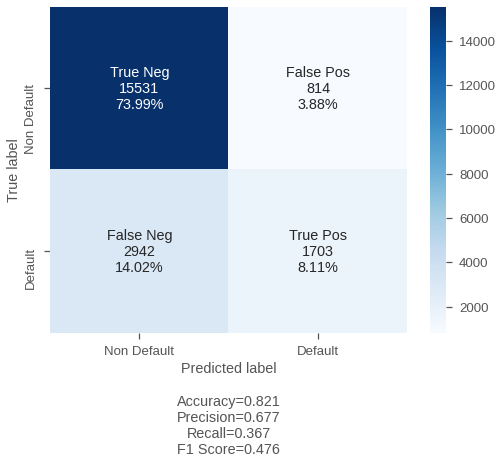

In [58]:
labels = ["True Neg", "False Pos", "False Neg", "True Pos"]
categories = ["Non Default", "Default"]
make_confusion_matrix(
    cf_matrix_traing,
    group_names=labels,
    categories=categories,
    figsize=(8, 6),
    cmap="Blues",
)

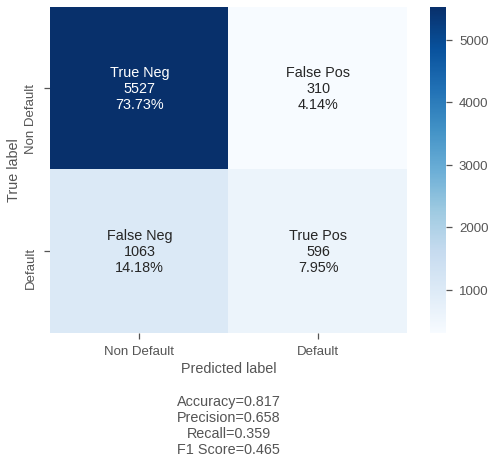

In [59]:
make_confusion_matrix(
    cf_matrix_val,
    group_names=labels,
    categories=categories,
    figsize=(8, 6),
    cmap="Blues",
)

* Regularization worked, both validation and traning datasets are giving similar metrics.

In [60]:
# probabilitis of validation set
y_pred_val_lgb = lightgbm_tuned_mode.predict_proba(X_val)
probs = y_pred_val_lgb[:, 1]
probs

array([0.55932042, 0.74492751, 0.21181946, ..., 0.24009216, 0.85179628,
       0.71623195])

## Defining Threshold

* The default threshold in classification is 0.5. I am assuming at this point, I talked with the stakeholders and they decided to set a Recall score 0.7. 
* This means from all next months default accounts, algorithm will catch 70% of them. 
* New threshold will bring many False Positives. But FP might be tolerable. This means, when model predict default but it was infact not default. This might bring less harm to bank.

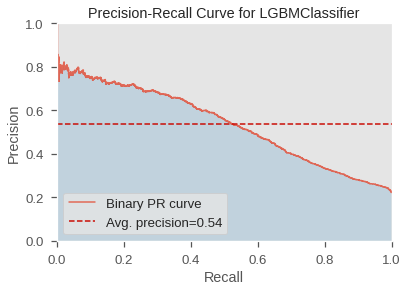

In [62]:
# Create the visualizer, fit, score, and show it
viz = PrecisionRecallCurve(lightgbm_tuned_mode)
viz.fit(X_train, y_train)
viz.score(X_val, y_val)
viz.show()

At above figure 
* X axis is recall, 
* Y axis is precision

In [63]:
def to_labels(pos_probs, threshold):
    """
    Given threshold, function returns the class
    """

    return (pos_probs >= threshold).astype("int")


# searching thresholds
threshold = arange(0, 1, 0.001)

# threshold scores based on recall
treshold_scores = [recall_score(y_val, to_labels(probs, t)) for t in threshold]
ix = argmax(treshold_scores)
print("Threshold=%.3f, Recall=%.5f" % (threshold[ix], treshold_scores[ix]))

Threshold=0.000, Recall=1.00000


In [64]:
# to find right threshold
for ind_threshold, ind_scores in zip(threshold, treshold_scores):
    if ind_scores > 0.69 and ind_scores < 0.71:
        print(ind_threshold, ind_scores)

0.178 0.707655213984328
0.179 0.7064496684749849
0.18 0.7058468957203134
0.181 0.7040385774562989
0.182 0.701627486437613
0.183 0.7010247136829415
0.184 0.6986136226642555
0.185 0.6949969861362266
0.186 0.6931886678722122
0.187 0.6913803496081977


I have picked the threshold as 0.184. New predictins are shown below

In [65]:
y_pred_train_threshold = (
    lightgbm_tuned_mode.predict_proba(X_train)[:, 1] >= 0.184
).astype(
    bool
)  # set threshold as 0.19
y_pred_val_threshold = (lightgbm_tuned_mode.predict_proba(X_val)[:, 1] >= 0.184).astype(
    bool
)  # set threshold as 0.19

New confusion matrix are calculated based on the threshold 

In [66]:
cf_matrix_traing_threshold = confusion_matrix(
    y_train, y_pred_train_threshold, labels=[0, 1]
)
cf_matrix_val_threshold = confusion_matrix(y_val, y_pred_val_threshold, labels=[0, 1])

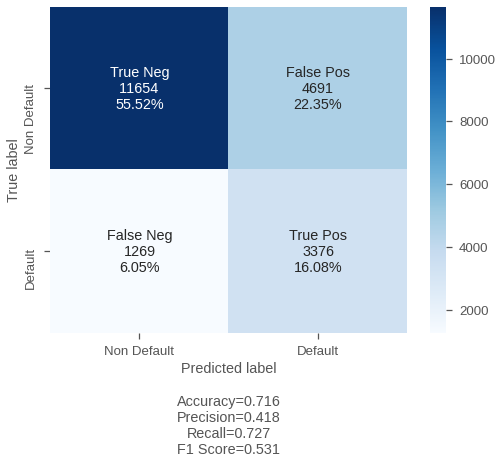

In [67]:
make_confusion_matrix(
    cf_matrix_traing_threshold,
    group_names=labels,
    categories=categories,
    figsize=(8, 6),
    cmap="Blues",
)

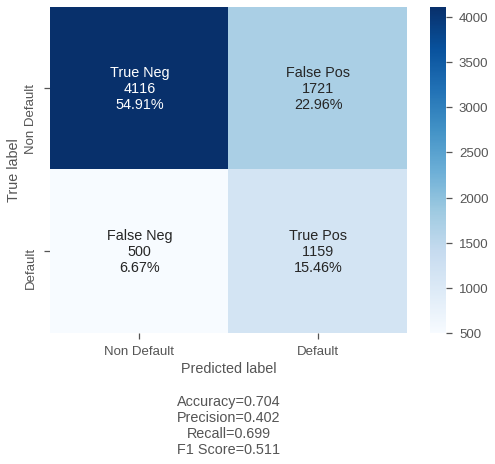

In [68]:
make_confusion_matrix(
    cf_matrix_val_threshold,
    group_names=labels,
    categories=categories,
    figsize=(8, 6),
    cmap="Blues",
)

* Structure of three shown below.

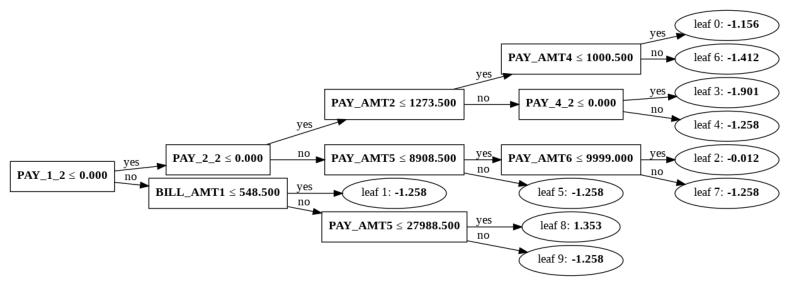

In [76]:
import lightgbm as lgb

lgb.plot_tree(lightgbm_tuned_mode, figsize=(25, 5))


PAY_AMT2, BILL_AMT1, LIMIT_VAL, and CLOSENESS_3 are the top four important parameters for the model.

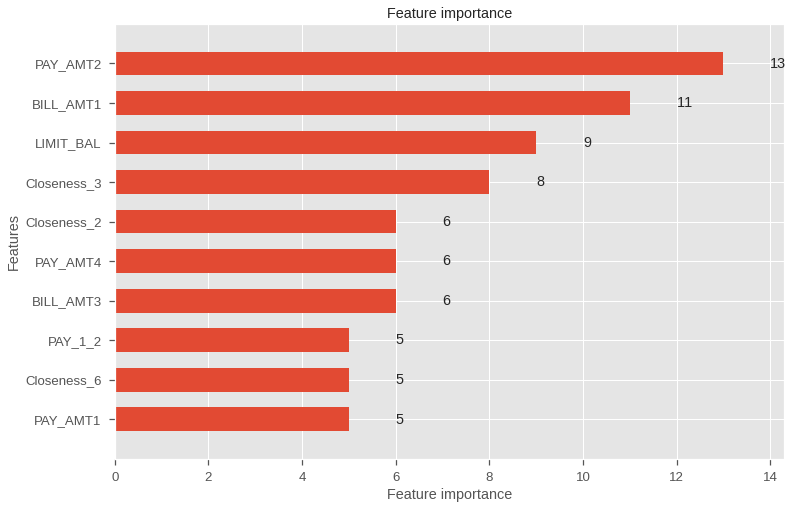

In [80]:
ax = lgb.plot_importance(
    lightgbm_tuned_mode, height=0.6, max_num_features=10, figsize=(12, 8)
)
plt.show()

# Testing with Unseen Data  

In [69]:
y_pred_test = (lightgbm_tuned_mode.predict_proba(X_test)[:, 1] >= 0.184).astype(
    bool
)  # set threshold as 0.19
cf_matrix_test = confusion_matrix(y_test, y_pred_test, labels=[0, 1])

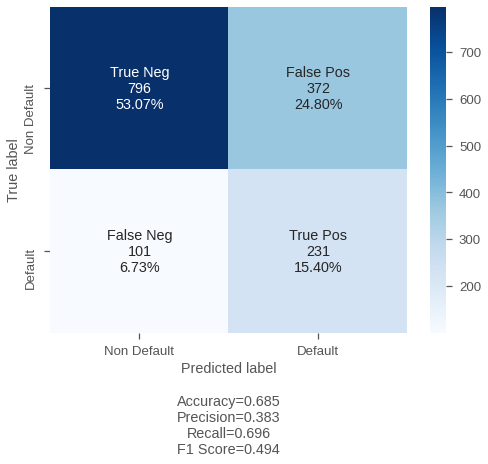

In [70]:
make_confusion_matrix(
    cf_matrix_test,
    group_names=labels,
    categories=categories,
    figsize=(8, 6),
    cmap="Blues",
) 

In [392]:
# converting test predictions to panda series
prediction_dataframe = pd.get_dummies(y_pred_test, prefix="pre")
prediction_dataframe.drop(["pre_False"], axis=1, inplace=True)
prediction_dataframe.rename(columns={"pre_True": "Predictions"}, inplace=True)

* Join test dataset, target and predictions in one frame

In [396]:
final_predictions = X_test.join(y_test).join(prediction_dataframe)

In [397]:
final_predictions.head()

,LIMIT_BAL,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,Closeness_6,Closeness_5,Closeness_4,Closeness_3,Closeness_2,Closeness_1,EDU_1,EDU_2,EDU_3,EDU_4,EDU_5,MAR_1,MAR_2,MAR_3,PAY_1_-2,PAY_1_-1,PAY_1_0,PAY_1_1,PAY_1_2,PAY_1_3,PAY_1_4,PAY_1_5,PAY_1_6,PAY_1_7,PAY_1_8,PAY_2_-2,PAY_2_-1,PAY_2_0,PAY_2_1,PAY_2_2,PAY_2_3,PAY_2_4,PAY_2_5,PAY_2_6,PAY_2_7,PAY_2_8,PAY_3_-2,PAY_3_-1,PAY_3_0,PAY_3_1,PAY_3_2,PAY_3_3,PAY_3_4,PAY_3_5,PAY_3_6,PAY_3_7,PAY_3_8,PAY_4_-2,PAY_4_-1,PAY_4_0,PAY_4_1,PAY_4_2,PAY_4_3,PAY_4_4,PAY_4_5,PAY_4_6,PAY_4_7,PAY_4_8,PAY_5_-2,PAY_5_-1,PAY_5_0,PAY_5_2,PAY_5_3,PAY_5_4,PAY_5_5,PAY_5_6,PAY_5_7,PAY_5_8,PAY_6_-2,PAY_6_-1,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8,SEMA_1,SEMA_2,SEMA_3,SEMA_4,SEMA_5,SEMA_6,AGE_1,AGE_2,AGE_3,AGE_4,AGE_5,SEAG_1,SEAG_2,SEAG_3,SEAG_4,SEAG_5,SEAG_6,SEAG_7,SEAG_8,SEAG_9,SEAG_10,GENDER_1,Default,Predictions
0,80000,2,38370,39448,58788,62814,61682,65644,2000,20000,5000,0,5010,2500,0.18,0.23,0.21,0.27,0.51,0.52,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,1
1,150000,2,127204,247984,125502,129589,133145,139322,5900,5000,6163,7200,10500,4900,0.07,0.11,0.14,0.16,-0.65,0.15,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
2,200000,-1,2318,7298,0,0,0,980,7478,0,0,0,980,0,1.00,1.00,1.00,1.00,0.96,0.99,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
3,50000,0,30941,30730,29908,28809,27905,13835,1751,1402,776,773,522,430,0.72,0.44,0.42,0.40,0.39,0.38,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
4,280000,0,192045,195162,198105,202919,197380,201927,9300,9500,9509,7100,7800,8200,0.28,0.30,0.28,0.29,0.30,0.31,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


The test probabilities can be seen with below function

In [398]:
lightgbm_tuned_mode.predict_proba(X_test)

array([[0.66147128, 0.33852872],
       [0.86848026, 0.13151974],
       [0.85087734, 0.14912266],
       ...,
       [0.94314768, 0.05685232],
       [0.9425693 , 0.0574307 ],
       [0.31838565, 0.68161435]])

In [352]:
(lightgbm_tuned_mode.predict_proba(X_test)[0, 1] >= 0.184).astype(bool)

True

## Saving model

In [71]:
pickle.dump(lightgbm_tuned_mode, open("lightgbm.pickle", "wb"))

In [ ]:
lightgbm = pickle.load(open("lightgbm.pickle", "rb"))

# Result

1. In this task, an automated machine learning package is used to explore various methods. Light Gradient Boosting Machine is chosen as the best model for the problem because of its performance and its accuracy.
 
2. Various feature engineering has been applied to increase the prediction power of the models.
 
3. Final test scores are very similar to training and validation metrics. The most important metric that I have considered for this task was to recall. The Business wants to have a 70% recall rate. The model recall performance on training data is almost 73%. The validation dataset shows 70% and the test dataset is 70%.
 
4. In the final test set (1500 accounts), where I have not used in any stage, 231 default, and 796 non-defaults are correctly identified. There are 101 Type II error and 372 Type I errors. That means 102 accounts out of 1500 accounts are considered non-default by the model where these accounts were default.

# Acknowledgements

Lichman, M. (2013). UCI Machine Learning Repository [http://archive.ics.uci.edu/ml]. Irvine, CA: University of California, School of Information and Computer Science.

The original dataset can be found here at the UCI Machine Learning Repository.